## Import packages

In [3]:
import pandas as pd
pd.set_option('display.max_columns', None)
# import geopandas as gpd


import numpy as np
import math
import pickle

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

from xgboost import XGBClassifier


from sklearn.feature_selection import SelectFromModel
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder, FunctionTransformer, OrdinalEncoder
from sklearn.impute import SimpleImputer, KNNImputer,MissingIndicator
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import plot_confusion_matrix, recall_score,\
    accuracy_score, precision_score, f1_score


### Load prep data

In [4]:
df = pd.read_csv('./data/processed.csv')
df.drop('Unnamed: 0',axis=1,inplace=True)

df.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,id.1,status_group,coord,age_well,amount_ths_zero,district-region
0,69572,6000.0,2011-03-14,Roman,1390.0,Other,34.94,-9.86,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109.0,True,GeoData Consultants Ltd,VWC,Roman,False,1999.0,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,soft,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,69572,functional,"(-9.85632177, 34.93809275)",12.0,0,5-11
1,8776,0.0,2013-03-06,Other,1399.0,Other,34.70,-2.15,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280.0,NaN,GeoData Consultants Ltd,Other,NaN,True,2010.0,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,soft,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,8776,functional,"(-2.14746569, 34.6987661)",3.0,1,2-20
2,34310,25.0,2013-02-25,Other,686.0,World vision,37.46,-3.82,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250.0,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009.0,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,soft,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,34310,functional,"(-3.82132853, 37.46066446)",4.0,0,4-21
3,67743,0.0,2013-01-28,Unicef,263.0,UNICEF,38.49,-11.16,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58.0,True,GeoData Consultants Ltd,VWC,NaN,True,1986.0,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,soft,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,67743,Needs Repairs,"(-11.15529772, 38.48616088)",27.0,1,63-90
4,19728,0.0,2011-07-13,Other,NaN,Other,31.13,-1.83,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,NaN,True,GeoData Consultants Ltd,NaN,NaN,True,NaN,gravity,gravity,gravity,other,other,never pay,never pay,soft,soft,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,19728,functional,"(-1.82535885, 31.13084671)",NaN,1,1-18


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57422 entries, 0 to 57421
Data columns (total 46 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     57422 non-null  int64  
 1   amount_tsh             57422 non-null  float64
 2   date_recorded          57422 non-null  object 
 3   funder                 57422 non-null  object 
 4   gps_height             38810 non-null  float64
 5   installer              57422 non-null  object 
 6   longitude              57422 non-null  float64
 7   latitude               57422 non-null  float64
 8   wpt_name               57422 non-null  object 
 9   num_private            57422 non-null  int64  
 10  basin                  57422 non-null  object 
 11  subvillage             57051 non-null  object 
 12  region                 57422 non-null  object 
 13  region_code            57422 non-null  int64  
 14  district_code          57422 non-null  int64  
 15  lg

Drop columns we already know we don't want. Reasons these columns are dropped are detailed in (preprocessing notebook)[link].

In [6]:
#Drop columns we already know we don't want

col_drop = ['district_code','wpt_name', 'payment', 'num_private', 'extraction_type_group', 'water_quality', 'quantity_group', 'management','id','scheme_name', 'extraction_type', 'source', 'waterpoint_type', 'recorded_by', 'subvillage', 'ward','coord','construction_year','id.1','region_code','date_recorded']

df = df.drop(col_drop,axis=1)

df.head()

,amount_tsh,funder,gps_height,installer,longitude,latitude,basin,region,lga,population,public_meeting,scheme_management,permit,extraction_type_class,management_group,payment_type,quality_group,quantity,source_type,source_class,waterpoint_type_group,status_group,age_well,amount_ths_zero,district-region
0,6000.0,Roman,1390.0,Other,34.94,-9.86,Lake Nyasa,Iringa,Ludewa,109.0,True,VWC,False,gravity,user-group,annually,soft,enough,spring,groundwater,communal standpipe,functional,12.0,0,5-11
1,0.0,Other,1399.0,Other,34.70,-2.15,Lake Victoria,Mara,Serengeti,280.0,NaN,Other,True,gravity,user-group,never pay,soft,insufficient,rainwater harvesting,surface,communal standpipe,functional,3.0,1,2-20
2,25.0,Other,686.0,World vision,37.46,-3.82,Pangani,Manyara,Simanjiro,250.0,True,VWC,True,gravity,user-group,per bucket,soft,enough,dam,surface,communal standpipe,functional,4.0,0,4-21
3,0.0,Unicef,263.0,UNICEF,38.49,-11.16,Ruvuma / Southern Coast,Mtwara,Nanyumbu,58.0,True,VWC,True,submersible,user-group,never pay,soft,dry,borehole,groundwater,communal standpipe,Needs Repairs,27.0,1,63-90
4,0.0,Other,NaN,Other,31.13,-1.83,Lake Victoria,Kagera,Karagwe,NaN,True,NaN,True,gravity,other,never pay,soft,seasonal,rainwater harvesting,surface,communal standpipe,functional,NaN,1,1-18


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57422 entries, 0 to 57421
Data columns (total 25 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   amount_tsh             57422 non-null  float64
 1   funder                 57422 non-null  object 
 2   gps_height             38810 non-null  float64
 3   installer              57422 non-null  object 
 4   longitude              57422 non-null  float64
 5   latitude               57422 non-null  float64
 6   basin                  57422 non-null  object 
 7   region                 57422 non-null  object 
 8   lga                    57422 non-null  object 
 9   population             30858 non-null  float64
 10  public_meeting         54476 non-null  object 
 11  scheme_management      53672 non-null  object 
 12  permit                 54381 non-null  object 
 13  extraction_type_class  57422 non-null  object 
 14  management_group       57422 non-null  object 
 15  pa

Let's make our target into 1s and 0s. Our target will be 1 if it needs repairs, and 0 if it doesn't.

In [8]:
df['status_group'] = [0 if x=='functional' else 1 for x in df['status_group']]
df.status_group

0        0
1        0
2        0
3        1
4        0
        ..
57417    0
57418    0
57419    0
57420    0
57421    0
Name: status_group, Length: 57422, dtype: int64

In [9]:
df['status_group'].value_counts(normalize=True)

0    0.544582
1    0.455418
Name: status_group, dtype: float64

### Train-test-split

Let's do our train-test-split before we begin to build our pipelines.

In [10]:
X = df.drop('status_group',axis=1)
y = df['status_group']

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

In [11]:
X_train

,amount_tsh,funder,gps_height,installer,longitude,latitude,basin,region,lga,population,public_meeting,scheme_management,permit,extraction_type_class,management_group,payment_type,quality_group,quantity,source_type,source_class,waterpoint_type_group,age_well,amount_ths_zero,district-region
48401,0.0,Other,NaN,Other,32.09,-5.18,Lake Tanganyika,Tabora,Urambo,NaN,True,VWC,True,other,user-group,other,soft,dry,shallow well,groundwater,other,NaN,1,4-14
9625,0.0,Adb,1106.0,Other,36.31,-2.79,Internal,Arusha,Longido,400.0,True,VWC,True,gravity,user-group,on failure,soft,insufficient,river/lake,surface,communal standpipe,8.0,1,6-2
27771,0.0,Tcrs,1387.0,TCRS,34.46,-4.81,Internal,Singida,Iramba,215.0,True,VWC,True,other,user-group,never pay,soft,enough,shallow well,groundwater,other,27.0,1,1-13
27727,0.0,Dwe,1875.0,DWE,31.83,-8.25,Lake Rukwa,Rukwa,Sumbawanga Rural,350.0,True,VWC,False,other,user-group,never pay,soft,enough,spring,groundwater,other,19.0,1,2-15
54,6.0,Other,962.0,DWE,37.48,-3.37,Pangani,Kilimanjaro,Moshi Rural,45.0,True,Water Board,True,gravity,user-group,per bucket,soft,enough,spring,groundwater,communal standpipe,5.0,0,4-3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54343,0.0,Kkkt,NaN,KKKT,33.18,-9.15,Lake Rukwa,Mbeya,Mbozi,NaN,False,VWC,False,handpump,user-group,on failure,soft,insufficient,shallow well,groundwater,hand pump,NaN,1,6-12
38158,2000.0,Other,NaN,DW,37.20,-6.03,Wami / Ruvu,Tanga,Kilindi,500.0,True,VWC,True,handpump,user-group,annually,salty,insufficient,shallow well,groundwater,hand pump,16.0,0,1-5
860,400.0,Other,428.0,DH,37.14,-6.70,Wami / Ruvu,Morogoro,Kilosa,100.0,True,VWC,True,handpump,user-group,on failure,soft,insufficient,shallow well,groundwater,hand pump,30.0,0,1-5
15795,0.0,Rc Church,NaN,Other,34.10,-3.95,Internal,Shinyanga,Kishapu,NaN,False,Parastatal,True,wind-powered,parastatal,per bucket,soft,dry,river/lake,surface,communal standpipe,NaN,1,80-17


In [12]:
y_train

48401    1
9625     1
27771    1
27727    1
54       0
        ..
54343    1
38158    0
860      0
15795    1
56422    0
Name: status_group, Length: 43066, dtype: int64

## Model Testing

We are going to begin our model testing with our training data. We will be using pipelines and Function transformer to smooth our model building process and ensure no data leakage takes place in our workflow.

### Building `FunctionTransformers`

#### Defining functions

In [13]:
def add_missing_indicator_columns(X):
    """
    Helper function for transforming features
    
    For every feature in X, create another feature indicating whether that feature
    is missing. (This doubles the number of columns in X.)
    
    Return: Original dataframe along with new feature that indicates missing values in our original features. Only returns
    columns that have missing values.
    """
    indicator = MissingIndicator(features='all')
    
    indicator.fit(X)
    # create a 2D array of True and False values indicating whether a given feature
    # is missing for that row
    missing_array_bool = indicator.transform(X)
    
    # transform into 1 and 0 for modeling
    missing_array_int = missing_array_bool.astype(int)
    
    # helpful for readability but not needed for modeling
    missing_column_names = [col + "_missing" for col in X.columns]
    
    # convert to df so it we can concat with X
    missing_df = pd.DataFrame(missing_array_int, columns=missing_column_names, index=X.index)
    
    #drop missing indicator columns that dont have any missing values.
    for col in missing_df.columns:
        if missing_df[col].sum()==0:
            missing_df = missing_df.drop(col,axis=1)

    #Concat the df
    complete_df = pd.concat([X, missing_df], axis=1)
    
    return complete_df

In [14]:
def grab_numeric(df):
    
    """
    Helper function to grab only numeric columns from our dataframe.
    """
    return df.select_dtypes(include=['float', 'int'])

In [15]:
def grab_object(df):
    
    """
    Helper function to grab only categorical columns from our dataframe.
    """
    
    return df.select_dtypes(include=['object'])

#### Testing functions

In [16]:
#Sniff test, ensuring function outputs what we want

add_missing_indicator_columns(X)

,amount_tsh,funder,gps_height,installer,longitude,latitude,basin,region,lga,population,public_meeting,scheme_management,permit,extraction_type_class,management_group,payment_type,quality_group,quantity,source_type,source_class,waterpoint_type_group,age_well,amount_ths_zero,district-region,gps_height_missing,population_missing,public_meeting_missing,scheme_management_missing,permit_missing,age_well_missing
0,6000.0,Roman,1390.0,Other,34.94,-9.86,Lake Nyasa,Iringa,Ludewa,109.0,True,VWC,False,gravity,user-group,annually,soft,enough,spring,groundwater,communal standpipe,12.0,0,5-11,0,0,0,0,0,0
1,0.0,Other,1399.0,Other,34.70,-2.15,Lake Victoria,Mara,Serengeti,280.0,NaN,Other,True,gravity,user-group,never pay,soft,insufficient,rainwater harvesting,surface,communal standpipe,3.0,1,2-20,0,0,1,0,0,0
2,25.0,Other,686.0,World vision,37.46,-3.82,Pangani,Manyara,Simanjiro,250.0,True,VWC,True,gravity,user-group,per bucket,soft,enough,dam,surface,communal standpipe,4.0,0,4-21,0,0,0,0,0,0
3,0.0,Unicef,263.0,UNICEF,38.49,-11.16,Ruvuma / Southern Coast,Mtwara,Nanyumbu,58.0,True,VWC,True,submersible,user-group,never pay,soft,dry,borehole,groundwater,communal standpipe,27.0,1,63-90,0,0,0,0,0,0
4,0.0,Other,NaN,Other,31.13,-1.83,Lake Victoria,Kagera,Karagwe,NaN,True,NaN,True,gravity,other,never pay,soft,seasonal,rainwater harvesting,surface,communal standpipe,NaN,1,1-18,1,1,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57417,10.0,Germany Republi,1210.0,CES,37.17,-3.25,Pangani,Kilimanjaro,Hai,125.0,True,Water Board,True,gravity,user-group,per bucket,soft,enough,spring,groundwater,communal standpipe,14.0,0,5-3,0,0,0,0,0,0
57418,4700.0,Other,1212.0,Other,35.25,-9.07,Rufiji,Iringa,Njombe,56.0,True,VWC,True,gravity,user-group,annually,soft,enough,river/lake,surface,communal standpipe,15.0,0,4-11,0,0,0,0,0,0
57419,0.0,Other,NaN,Other,34.02,-8.75,Rufiji,Mbeya,Mbarali,NaN,True,VWC,False,handpump,user-group,monthly,fluoride,enough,borehole,groundwater,hand pump,NaN,1,7-12,1,1,0,0,0,1
57420,0.0,Other,NaN,Other,35.86,-6.38,Rufiji,Dodoma,Chamwino,NaN,True,VWC,True,handpump,user-group,never pay,soft,insufficient,shallow well,groundwater,hand pump,NaN,1,4-1,1,1,0,0,0,1


In [17]:
#Sniff test, ensuring function outputs what we want

num_df=grab_numeric(df)
num_df

,amount_tsh,gps_height,longitude,latitude,population,age_well
0,6000.0,1390.0,34.94,-9.86,109.0,12.0
1,0.0,1399.0,34.70,-2.15,280.0,3.0
2,25.0,686.0,37.46,-3.82,250.0,4.0
3,0.0,263.0,38.49,-11.16,58.0,27.0
4,0.0,NaN,31.13,-1.83,NaN,NaN
...,...,...,...,...,...,...
57417,10.0,1210.0,37.17,-3.25,125.0,14.0
57418,4700.0,1212.0,35.25,-9.07,56.0,15.0
57419,0.0,NaN,34.02,-8.75,NaN,NaN
57420,0.0,NaN,35.86,-6.38,NaN,NaN


In [18]:
#Sniff test, ensuring function outputs what we want

cat_df = grab_object(df)
cat_df.head()

,funder,installer,basin,region,lga,public_meeting,scheme_management,permit,extraction_type_class,management_group,payment_type,quality_group,quantity,source_type,source_class,waterpoint_type_group,district-region
0,Roman,Other,Lake Nyasa,Iringa,Ludewa,True,VWC,False,gravity,user-group,annually,soft,enough,spring,groundwater,communal standpipe,5-11
1,Other,Other,Lake Victoria,Mara,Serengeti,NaN,Other,True,gravity,user-group,never pay,soft,insufficient,rainwater harvesting,surface,communal standpipe,2-20
2,Other,World vision,Pangani,Manyara,Simanjiro,True,VWC,True,gravity,user-group,per bucket,soft,enough,dam,surface,communal standpipe,4-21
3,Unicef,UNICEF,Ruvuma / Southern Coast,Mtwara,Nanyumbu,True,VWC,True,submersible,user-group,never pay,soft,dry,borehole,groundwater,communal standpipe,63-90
4,Other,Other,Lake Victoria,Kagera,Karagwe,True,NaN,True,gravity,other,never pay,soft,seasonal,rainwater harvesting,surface,communal standpipe,1-18


In [19]:
cat_df.isna().sum()/len(df)

funder                   0.000000
installer                0.000000
basin                    0.000000
region                   0.000000
lga                      0.000000
public_meeting           0.051304
scheme_management        0.065306
permit                   0.052959
extraction_type_class    0.000000
management_group         0.000000
payment_type             0.000000
quality_group            0.000000
quantity                 0.000000
source_type              0.000000
source_class             0.000000
waterpoint_type_group    0.000000
district-region          0.000000
dtype: float64

To show the spread of our models, let's make a convenient class that can help us organize the model and the cross-validation:

In [20]:
class ModelWithCV():
    '''Structure to save the model and more easily see its crossvalidation'''
    
    def __init__(self, model, model_name, X, y, cv_now=True):
        self.model = model
        self.name = model_name
        self.X = X
        self.y = y
        # For CV results
        self.cv_results = None
        self.cv_mean = None
        self.cv_median = None
        self.cv_std = None
        #
        if cv_now:
            self.cross_validate()
        
    def cross_validate(self, X=None, y=None, kfolds=5):
        '''
        Perform cross-validation and return results.
        
        Args: 
          X:
            Optional; Training data to perform CV on. Otherwise use X from object
          y:
            Optional; Training data to perform CV on. Otherwise use y from object
          kfolds:
            Optional; Number of folds for CV (default is 10)  
        '''
        
        cv_X = X if X else self.X
        cv_y = y if y else self.y

        self.cv_results = cross_val_score(self.model, cv_X, cv_y, cv=kfolds)
        self.cv_mean = np.mean(self.cv_results)
        self.cv_median = np.median(self.cv_results)
        self.cv_std = np.std(self.cv_results)

        
    def print_cv_summary(self):
        cv_summary = (
        f'''CV Results for `{self.name}` model:
            {self.cv_mean:.5f} ± {self.cv_std:.5f} accuracy
        ''')
        print(cv_summary)

        
    def plot_cv(self, ax):
        '''
        Plot the cross-validation values using the array of results and given 
        Axis for plotting.
        '''
        ax.set_title(f'CV Results for `{self.name}` Model')
        # Thinner violinplot with higher bw
        sns.violinplot(y=self.cv_results, ax=ax, bw=.4)
        sns.swarmplot(
                y=self.cv_results,
                color='orange',
                size=10,
                alpha= 0.8,
                ax=ax
        )

        return ax

Some of these models take a very long time to run. The function below will pickle the models we have to [pickled_models](link).

In [21]:
def pickle_model (model,model_file_name):
    
    """
    This helper function takes in your model and save it under modelname, in a folder parallel to the parent director called
    pickled_models.
    
    model: the model to save.
    model_file_name: (str) file name to save the model as. 
    """
    print (f'Saving model as {model_file_name}...')
    pickle.dump(model,open(f'./pickled_models/{model_file_name}.sav','wb'))
    print(f'{model_file_name} succesfully saved.')
           
    
    

In [22]:
def scoring(estimator, X, y):
    '''
    Prints the accuracy, precision, and recall of the given fitted estimator and data.
    
    Prints the confusion matrix.
    '''
    p_score = precision_score(y, estimator.predict(X))
    r_score = recall_score(y, estimator.predict(X))
    
    print(f'Accuracy: {estimator.score(X, y)}')
    print(f'Precision: {p_score}')
    print(f'Recall: {r_score}')
    
    plot_confusion_matrix(estimator, X, y)

#### Transforming functions

In [23]:
GrabNumeric = FunctionTransformer(grab_numeric)
GrabObject = FunctionTransformer(grab_object)
MissIndCols = FunctionTransformer(add_missing_indicator_columns)

### Building `subpipelines` and `Column Transformer`

In [24]:
# We'll throw these mini-pipelines into our ColumnTransformer: numeric and categorical
# We'll throw these mini-pipelines into our ColumnTransformer: numeric and categorical

subpipe_num = Pipeline(steps=[('get_num', GrabNumeric),
                              ('add_missindcols',MissIndCols),
                              ('ss', StandardScaler()),
                              ('num_impute', KNNImputer())
                             ])


subpipe_cat = Pipeline(steps=[('get_obj', GrabObject),
                              ('cat_impute', SimpleImputer(strategy='most_frequent')),
                              ('ohe', OneHotEncoder(sparse=False, handle_unknown='ignore'))
                              ])

In [25]:
ct = ColumnTransformer(transformers = [
    ('subpipe_num', subpipe_num, X_train.columns),
    ('subpipe_cat', subpipe_cat, X_train.columns)
])


In [26]:
# pd.DataFrame(ct.fit_transform(X_train))

### Baseline model

In [166]:
#Build a dummy model pipeline

dummy_model_pipe = Pipeline(steps=[
    ('ct',ct),
    ('dummy_mod',DummyClassifier(random_state=42))
])

dummy_model_pipe.fit(X_train,y_train)

C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\dummy.py:131: FutureWarning: The default value of strategy will change from stratified to prior in 0.24.
  warnings.warn("The default value of strategy will change from "


Pipeline(steps=[('ct',
                 ColumnTransformer(transformers=[('subpipe_num',
                                                  Pipeline(steps=[('get_num',
                                                                   FunctionTransformer(func=<function grab_numeric at 0x0000023F6059D1F0>)),
                                                                  ('add_missindcols',
                                                                   FunctionTransformer(func=<function add_missing_indicator_columns at 0x0000023F58558790>)),
                                                                  ('ss',
                                                                   StandardScaler()),
                                                                  ('num_impute',
                                                                   KNNImputer())]),
                                                  Index(['amount_tsh', 'fun...
                                              

In [167]:
dummy_pipe = ModelWithCV(dummy_model_pipe,model_name = 'dummy_mod', X=X_train,y=y_train)

C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\dummy.py:131: FutureWarning: The default value of strategy will change from stratified to prior in 0.24.
  warnings.warn("The default value of strategy will change from "
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\dummy.py:131: FutureWarning: The default value of strategy will change from stratified to prior in 0.24.
  warnings.warn("The default value of strategy will change from "
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\dummy.py:131: FutureWarning: The default value of strategy will change from stratified to prior in 0.24.
  warnings.warn("The default value of strategy will change from "
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\dummy.py:131: FutureWarning: The default value of strategy will change from stratified to prior in 0.24.
  warnings.warn("The default value of strategy will change from "
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-pac

In [168]:
dummy_pipe.print_cv_summary()

CV Results for `dummy_mod` model:
            0.50506 ± 0.00722 accuracy
        


<AxesSubplot:title={'center':'CV Results for `dummy_mod` Model'}>

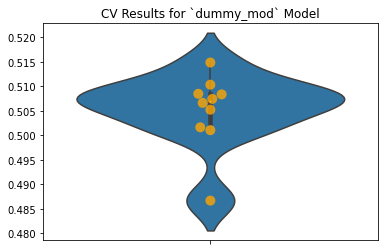

In [173]:
fig, ax = plt.subplots()
dummy_pipe.plot_cv(ax=ax)

In [197]:
#Pickling baseline model

pickle_model(dummy_model_pipe, 'dummy_model')

pickle_model(dummy_pipe, 'dummy_cv')

Saving model as dummy_model...
dummy_model succesfully saved.
Saving model as dummy_cv...
dummy_cv succesfully saved.


In [276]:
plot_roc_curve(dummy_model_pipe,X_train,y_train)

MemoryError: Unable to allocate 528. MiB for an array with shape (23174, 2984) and data type float64

### Logistic Classifier Model

Let's check the heat map to make sure our feature don't have multicolinearity amongst them.

<AxesSubplot:>

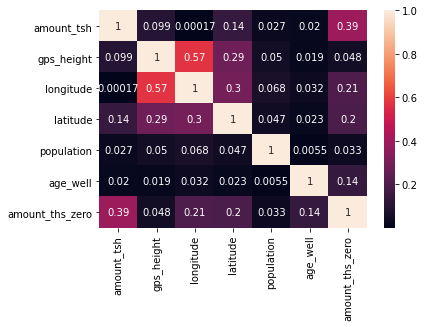

In [180]:
sns.heatmap(abs(X_train.corr()),annot=True)

In [181]:
#Build a log model pipeline

logreg_model_pipe = Pipeline(steps=[
    ('ct',ct),
    ('log_mod',LogisticRegression(random_state=42))
])

logreg_model_pipe.fit(X_train,y_train)

C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Pipeline(steps=[('ct',
                 ColumnTransformer(transformers=[('subpipe_num',
                                                  Pipeline(steps=[('get_num',
                                                                   FunctionTransformer(func=<function grab_numeric at 0x0000023F6059D1F0>)),
                                                                  ('add_missindcols',
                                                                   FunctionTransformer(func=<function add_missing_indicator_columns at 0x0000023F58558790>)),
                                                                  ('ss',
                                                                   StandardScaler()),
                                                                  ('num_impute',
                                                                   KNNImputer())]),
                                                  Index(['amount_tsh', 'fun...
                                              

In [182]:
logreg_mod = ModelWithCV(logreg_model_pipe,model_name = 'log_mod', X=X_train,y=y_train)

C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to 

In [183]:
logreg_mod.print_cv_summary()

CV Results for `log_mod` model:
            0.77119 ± 0.00688 accuracy
        


<AxesSubplot:title={'center':'CV Results for `log_mod` Model'}>

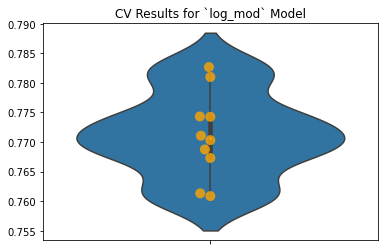

In [200]:
fig, ax = plt.subplots()
logreg_mod.plot_cv(ax=ax)

In [198]:
#Pickling log reg model

pickle_model(logreg_model_pipe, 'logreg_model')

pickle_model(logreg_mod, 'logreg_cv')

Saving model as logreg_model...
logreg_model succesfully saved.
Saving model as logreg_cv...
logreg_cv succesfully saved.


Accuracy: 0.7757163423582408
Precision: 0.7975335249042146
Recall: 0.6797285575794684


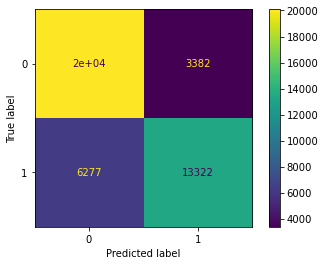

In [256]:
scoring(logreg_model_pipe,X_train,y_train)

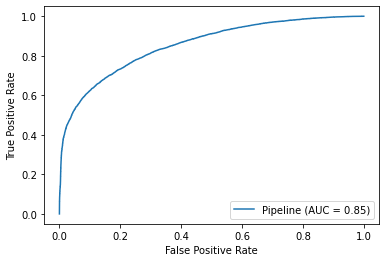

In [255]:
plot_roc_curve(logreg_model_pipe,X_train,y_train)

### Random Forest Classifier Model

In [187]:
#Build a log model pipeline

rfc_model_pipe = Pipeline(steps=[
    ('ct',ct),
    ('rfc_mod',RandomForestClassifier(random_state=42))
])

rfc_model_pipe.fit(X_train,y_train)


C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)


Pipeline(steps=[('ct',
                 ColumnTransformer(transformers=[('subpipe_num',
                                                  Pipeline(steps=[('get_num',
                                                                   FunctionTransformer(func=<function grab_numeric at 0x0000023F6059D1F0>)),
                                                                  ('add_missindcols',
                                                                   FunctionTransformer(func=<function add_missing_indicator_columns at 0x0000023F58558790>)),
                                                                  ('ss',
                                                                   StandardScaler()),
                                                                  ('num_impute',
                                                                   KNNImputer())]),
                                                  Index(['amount_tsh', 'fun...
       'latitude', 'basin', 'region', 'lga', '

In [188]:
rfc_mod = ModelWithCV(rfc_model_pipe,model_name = 'rfc_mod', X=X_train,y=y_train)

C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A c

In [190]:
rfc_mod.print_cv_summary()

CV Results for `rfc_mod` model:
            0.81735 ± 0.00557 accuracy
        


In [201]:
#Pickling RFC model

pickle_model(rfc_model_pipe, 'rfc_model')

pickle_model(rfc_mod, 'rfc_cv')

Saving model as rfc_model...
rfc_model succesfully saved.
Saving model as rfc_cv...
rfc_cv succesfully saved.


<AxesSubplot:xlabel='0'>

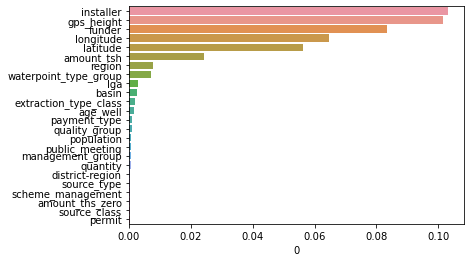

In [220]:
#Look at feature importance from RFC

feat_import = {name: score 
                   for name, score 
                       in zip(X_train.columns, rfc_model_pipe.named_steps["rfc_mod"].feature_importances_)
}
feat_import = pd.DataFrame(feat_import, index=[0]).T
feat_import = feat_import.sort_values(0, ascending=False)

sns.barplot(y = feat_import.index ,x=feat_import[0])

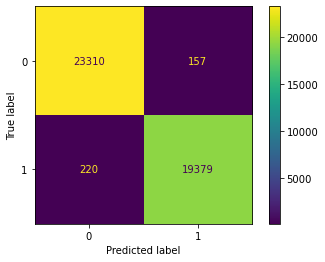

In [246]:
plot_confusion_matrix(rfc_model_pipe,X_train,y_train)

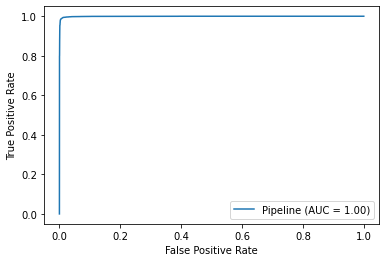

In [247]:
plot_roc_curve(rfc_model_pipe,X_train,y_train)

#### Random Forest Classifier Gridsearch

In [229]:
rfc_grid_params = {
    'rfc_mod__max_depth': [5, 20, 50],
    'rfc_mod__n_estimators': [10, 100, 400], 
    'rfc_mod__criterion':['gini', 'entropy'],
    'rfc_mod__verbose':[1],
    'rfc_mod__n_jobs':[-2]
}

rfc_grid = GridSearchCV(rfc_model_pipe, rfc_grid_params)

rfc_grid.fit(X_train,y_train)

C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done   8 out of  10 | elapsed:    3.3s remaining:    0.7s
[Parallel(n_jobs=-2)]: Done  10 out of  10 | elapsed:    3.3s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done   8 out of  10 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=7)]: Done  10 out of  10 | elapsed:    0.0s finished
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.

C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:    9.0s
[Parallel(n_jobs=-2)]: Done 400 out of 400 | elapsed:   17.7s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.1s
[Parallel(n_jobs=7)]: Done 400 out of 400 | elapsed:    0.2s finished
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expec

[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    6.5s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.1s finished
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    6.6s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel

C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done   8 out of  10 | elapsed:    0.9s remaining:    0.2s
[Parallel(n_jobs=-2)]: Done  10 out of  10 | elapsed:    1.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done   8 out of  10 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=7)]: Done  10 out of  10 | elapsed:    0.0s finished
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.

[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.2s
[Parallel(n_jobs=7)]: Done 400 out of 400 | elapsed:    0.6s finished
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:   12.9s
[Parallel(n_jobs=-2)]: Done 400 out of 400 | elapsed:   26.9s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.2s
[Parallel(n_jobs=7)]: Done 400 out of 400 | elapsed:    0.5s finished
C:\Users\hanis\anaconda3\envs

[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    2.9s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 100 out of 100 | elapsed:    0.0s finished
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeli

[Parallel(n_jobs=-2)]: Done   8 out of  10 | elapsed:    1.0s remaining:    0.2s
[Parallel(n_jobs=-2)]: Done  10 out of  10 | elapsed:    1.0s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done   8 out of  10 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=7)]: Done  10 out of  10 | elapsed:    0.0s finished
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-2)]: Done 100 out of 100 | elapsed:    6.2s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 t

[Parallel(n_jobs=-2)]: Done   8 out of  10 | elapsed:    1.1s remaining:    0.2s
[Parallel(n_jobs=-2)]: Done  10 out of  10 | elapsed:    1.2s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done   8 out of  10 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=7)]: Done  10 out of  10 | elapsed:    0.0s finished
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done   8 out of  10 | elapsed:    1.1s remaining:    0.2s
[Parallel(n_jobs=-2)]: Done  10 out of  10 | elapsed:    1.1s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_j

[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:   13.4s
[Parallel(n_jobs=-2)]: Done 400 out of 400 | elapsed:   27.5s finished
[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    0.3s
[Parallel(n_jobs=7)]: Done 400 out of 400 | elapsed:    0.6s finished
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\pipeline.py:335: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self._final_estimator.fit(Xt, y, **fit_params_last_step)
[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:   14.0s
[Parallel(n_jobs=-2)]: Done 400 out 

GridSearchCV(estimator=Pipeline(steps=[('ct',
                                        ColumnTransformer(transformers=[('subpipe_num',
                                                                         Pipeline(steps=[('get_num',
                                                                                          FunctionTransformer(func=<function grab_numeric at 0x0000023F6059D1F0>)),
                                                                                         ('add_missindcols',
                                                                                          FunctionTransformer(func=<function add_missing_indicator_columns at 0x0000023F58558790>)),
                                                                                         ('ss',
                                                                                          StandardScaler()),
                                                                                         ('num_impute',
  

In [230]:
pickle_model(rfc_grid,'rfc_gridCV')

Saving model as rfc_gridCV...
rfc_gridCV succesfully saved.


In [231]:
rfc_grid.best_estimator_

Pipeline(steps=[('ct',
                 ColumnTransformer(transformers=[('subpipe_num',
                                                  Pipeline(steps=[('get_num',
                                                                   FunctionTransformer(func=<function grab_numeric at 0x0000023F6059D1F0>)),
                                                                  ('add_missindcols',
                                                                   FunctionTransformer(func=<function add_missing_indicator_columns at 0x0000023F58558790>)),
                                                                  ('ss',
                                                                   StandardScaler()),
                                                                  ('num_impute',
                                                                   KNNImputer())]),
                                                  Index(['amount_tsh', 'fun...
       'scheme_management', 'permit', 'extract

In [232]:
rfc_grid.best_params_

{'rfc_mod__criterion': 'entropy',
 'rfc_mod__max_depth': 50,
 'rfc_mod__n_estimators': 400,
 'rfc_mod__n_jobs': -2,
 'rfc_mod__verbose': 1}

In [233]:
rfc_grid.best_score_

0.8173037010727059

[Parallel(n_jobs=7)]: Using backend ThreadingBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  36 tasks      | elapsed:    0.4s
[Parallel(n_jobs=7)]: Done 186 tasks      | elapsed:    1.9s
[Parallel(n_jobs=7)]: Done 400 out of 400 | elapsed:    3.8s finished


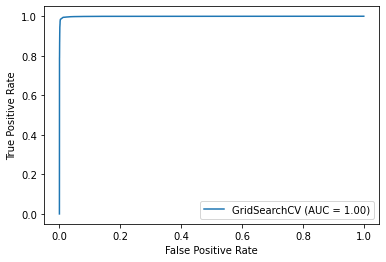

In [252]:
plot_roc_curve(rfc_grid,X_train,y_train)

### XGBoost Model

In [223]:
#Build a log model pipeline

xgc_model_pipe = Pipeline(steps=[
    ('ct',ct),
    ('xgc_mod',XGBClassifier(random_state=42, objective='binary:logistic'))
])

xgc_model_pipe.fit(X_train,y_train)


C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


Pipeline(steps=[('ct',
                 ColumnTransformer(transformers=[('subpipe_num',
                                                  Pipeline(steps=[('get_num',
                                                                   FunctionTransformer(func=<function grab_numeric at 0x0000023F6059D1F0>)),
                                                                  ('add_missindcols',
                                                                   FunctionTransformer(func=<function add_missing_indicator_columns at 0x0000023F58558790>)),
                                                                  ('ss',
                                                                   StandardScaler()),
                                                                  ('num_impute',
                                                                   KNNImputer())]),
                                                  Index(['amount_tsh', 'fun...
                               colsample_bytre

In [224]:
xgc_mod = ModelWithCV(xgc_model_pipe,model_name = 'xgc_mod', X=X_train,y=y_train)

C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)
C:\Users\hanis\anaconda3\envs\learn-env\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of 

In [225]:
xgc_mod.print_cv_summary()

CV Results for `xgc_mod` model:
            0.80648 ± 0.00596 accuracy
        


Accuracy: 0.8414294338921655
Precision: 0.8748825739783936
Recall: 0.760293892545538


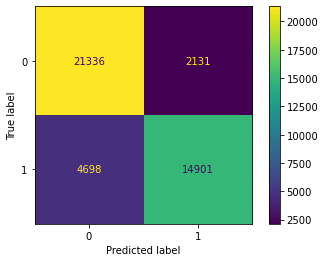

In [254]:
scoring(xgc_model_pipe,X_train,y_train)

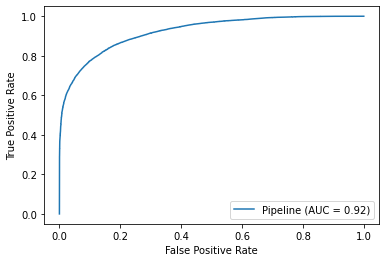

In [248]:
plot_roc_curve(xgc_model_pipe,X_train,y_train)

In [ ]:
roc_au

#### XGC Model Gridsearch

In [241]:
xgc_grid_params = {
    'xgc_mod__learning_rate': [0.01,0.1,0.2,0.5],
    'xgc_mod__n_estimators': [200,500,700], 
    'xgc_mod__criterion':['entropy'],
    'xgc_mod__verbose':[1],
    'xgc_mod__n_jobs':[-2]
}

xgc_grid = GridSearchCV(xgc_model_pipe, xgc_grid_params)

xgc_grid.fit(X_train,y_train)

[09:29:18] WARNING: C:\Users\Administrator\workspace\xgboost-win64_release_1.2.0\src\learner.cc:516: 
Parameters: { criterion, verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[09:31:33] WARNING: C:\Users\Administrator\workspace\xgboost-win64_release_1.2.0\src\learner.cc:516: 
Parameters: { criterion, verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[09:33:56] WARNING: C:\Users\Administrator\workspace\xgboost-win64_release_1.2.0\src\learner.cc:516: 
Parameters: { criterion, verbose } might not be used.

  This may not be accurate due to some parameters a

[10:26:02] WARNING: C:\Users\Administrator\workspace\xgboost-win64_release_1.2.0\src\learner.cc:516: 
Parameters: { criterion, verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:28:43] WARNING: C:\Users\Administrator\workspace\xgboost-win64_release_1.2.0\src\learner.cc:516: 
Parameters: { criterion, verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:31:15] WARNING: C:\Users\Administrator\workspace\xgboost-win64_release_1.2.0\src\learner.cc:516: 
Parameters: { criterion, verbose } might not be used.

  This may not be accurate due to some parameters a

[11:20:45] WARNING: C:\Users\Administrator\workspace\xgboost-win64_release_1.2.0\src\learner.cc:516: 
Parameters: { criterion, verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[11:23:50] WARNING: C:\Users\Administrator\workspace\xgboost-win64_release_1.2.0\src\learner.cc:516: 
Parameters: { criterion, verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[11:26:53] WARNING: C:\Users\Administrator\workspace\xgboost-win64_release_1.2.0\src\learner.cc:516: 
Parameters: { criterion, verbose } might not be used.

  This may not be accurate due to some parameters a

GridSearchCV(estimator=Pipeline(steps=[('ct',
                                        ColumnTransformer(transformers=[('subpipe_num',
                                                                         Pipeline(steps=[('get_num',
                                                                                          FunctionTransformer(func=<function grab_numeric at 0x0000023F6059D1F0>)),
                                                                                         ('add_missindcols',
                                                                                          FunctionTransformer(func=<function add_missing_indicator_columns at 0x0000023F58558790>)),
                                                                                         ('ss',
                                                                                          StandardScaler()),
                                                                                         ('num_impute',
  

In [242]:
xgc_grid.best_params_

{'xgc_mod__criterion': 'entropy',
 'xgc_mod__learning_rate': 0.2,
 'xgc_mod__n_estimators': 500,
 'xgc_mod__n_jobs': -2,
 'xgc_mod__verbose': 1}

In [243]:
xgc_grid.best_score_

0.8163749237758668

In [245]:
pickle_model(xgc_grid,'xgc_grid')

Saving model as xgc_grid...
xgc_grid succesfully saved.


Accuracy: 0.8943017693772349
Precision: 0.9208951048951048
Recall: 0.8398897902954232


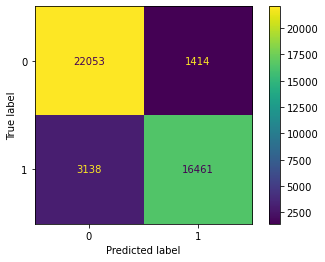

In [253]:
scoring(xgc_grid,X_train,y_train)

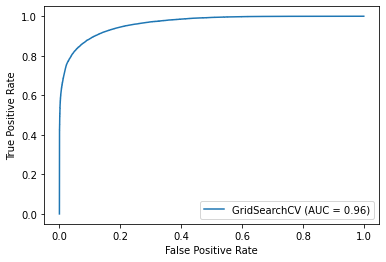

In [249]:
plot_roc_curve(xgc_grid,X_train,y_train)

### Best Model

#### Load pickled models

In [27]:
def load_pickle(fullfilepath):
    
    file = open(fullfilepath,'rb')
    object_file = pickle.load(file)
    file.close()
    
    return object_file

In [28]:
dummy_pickle = load_pickle("./pickled_models/dummy_cv.sav")
logreg_pickle = load_pickle("./pickled_models/logreg_cv.sav")
rfc_pickle = load_pickle("./pickled_models/rfc_cv.sav")
rfc_grid_pickle = load_pickle("./pickled_models/rfc_gridCV.sav")
# xgc_pickle = load_pickle("./pickled_models/")
xgc_grid_pickle = load_pickle("./pickled_models/xgc_grid.sav")

In [29]:
CV_scores_dict={'Baseline':[dummy_pickle.cv_mean, 0],'Logistic Regression':[logreg_pickle.cv_mean,0.85],\
               'Random Forest': [rfc_pickle.cv_mean,1.0],'Random Forest w/ hypertuning': [rfc_grid_pickle.best_score_,1.0],\
               'XGBC':[0.80648,0.92],'XGBC w/ hypertuning':[xgc_grid_pickle.best_score_,0.96]}

cv_scores = pd.DataFrame(CV_scores_dict,index=[0,1]).T

cv_scores.head()

,0,1
Baseline,0.505062,0.00
Logistic Regression,0.771189,0.85
Random Forest,0.817350,1.00
Random Forest w/ hypertuning,0.817304,1.00
XGBC,0.806480,0.92


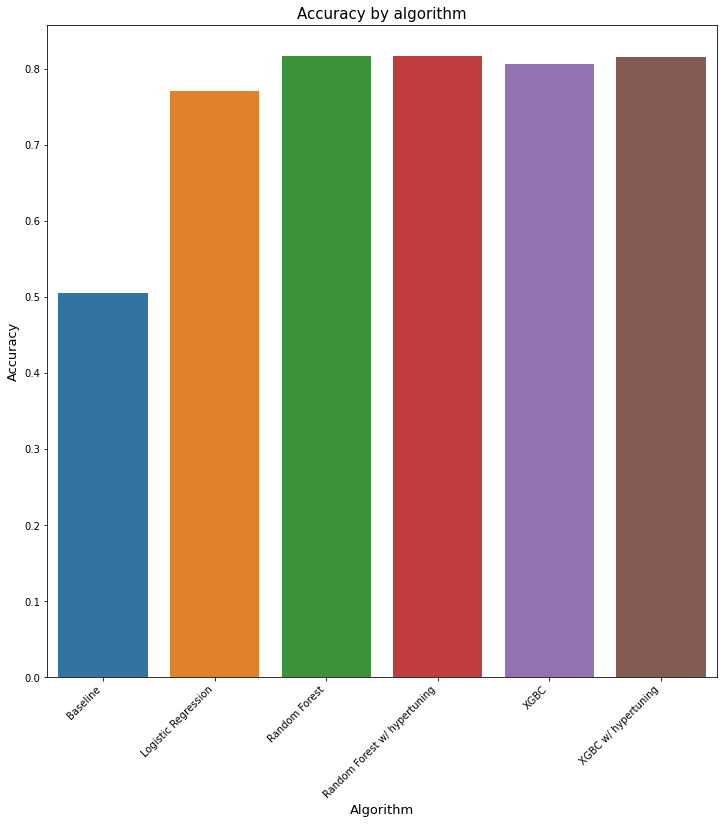

In [59]:
fig,ax = plt.subplots(figsize=(12,12))
sns.barplot(x=cv_scores.index,y=cv_scores[0],ax=ax)
# plt.bar(x=cv_scores.index,height=cv_scores[1])
ax.set_xlabel('Algorithm',fontdict={'fontsize':13})
ax.set_ylabel('Accuracy',fontdict={'fontsize':13})
ax.set_title('Accuracy by algorithm',fontdict={'fontsize':15})
ax.set_xticklabels(ax.get_xticklabels(),rotation = 45, fontsize =10, fontdict={'verticalalignment': 'top',\
                                                                             'horizontalalignment':'right'})
plt.savefig('./figures/model_comparison_accuracy.jpg',bbox_inches="tight")

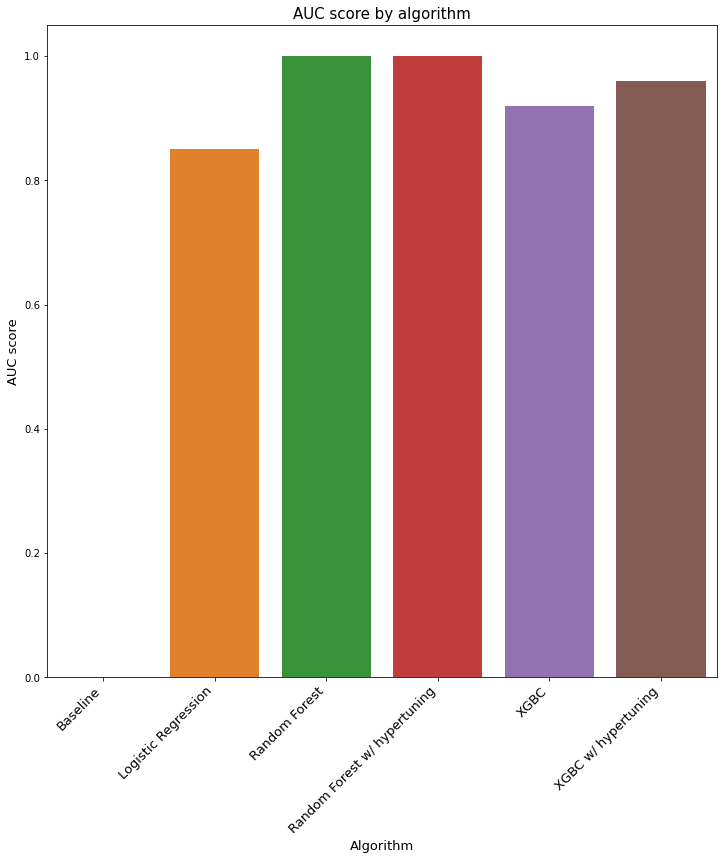

In [60]:
fig,ax = plt.subplots(figsize=(12,12))
sns.barplot(x=cv_scores.index,y=cv_scores[1],ax=ax)
# plt.bar(x=cv_scores.index,height=cv_scores[1])
ax.set_xlabel('Algorithm',fontdict={'fontsize':13})
ax.set_ylabel('AUC score',fontdict={'fontsize':13})
ax.set_title('AUC score by algorithm',fontdict={'fontsize':15})
ax.set_xticklabels(ax.get_xticklabels(),rotation = 45, fontsize =13, fontdict={'verticalalignment': 'top',\
                                                                             'horizontalalignment':'right'})
plt.savefig('./figures/model_comparison_auc.jpg',bbox_inches="tight")

### Spatial Analysis

In [29]:
# # data frame of geojson data that distinguishes tanzania region based on latitude and longitude
# geoJSON_df = gpd.read_file('data/gadm36_TZA_1.geojson')
# geoJSON_df = geoJSON_df.rename(columns = {"NAME_1":"region"})
# geoJSON_df

,NAME_0,region,geometry
0,Tanzania,Arusha,"MULTIPOLYGON (((36.86166 -3.58649, 36.86168 -3..."
1,Tanzania,Dar es Salaam,"MULTIPOLYGON (((39.49764 -7.18792, 39.49681 -7..."
2,Tanzania,Dodoma,"MULTIPOLYGON (((36.45322 -7.34548, 36.45518 -7..."
3,Tanzania,Geita,"MULTIPOLYGON (((31.81730 -2.70199, 31.81754 -2..."
4,Tanzania,Iringa,"MULTIPOLYGON (((35.76056 -8.62390, 35.76262 -8..."
5,Tanzania,Kagera,"MULTIPOLYGON (((30.65002 -2.97556, 30.65019 -2..."
6,Tanzania,Katavi,"MULTIPOLYGON (((30.50987 -6.91475, 30.51049 -6..."
7,Tanzania,Kigoma,"MULTIPOLYGON (((31.46194 -4.46209, 31.46115 -4..."
8,Tanzania,Kilimanjaro,"MULTIPOLYGON (((38.11968 -4.56962, 38.12009 -4..."
9,Tanzania,Lindi,"MULTIPOLYGON (((39.73347 -9.64097, 39.73180 -9..."


In [45]:
from pandas.io.json import json_normalize
df_json = json_normalize(geoJSON_raw["features"])

# coords = 'properties.geometry.MultiPolygon'

# df2 = (df[coords].apply(lambda r: [(i[0],i[1]) for i in r[0]])
#            .apply(pd.Series).stack()
#            .reset_index(level=1).rename(columns={0:coords,"level_1":"point"})
#            .join(df.drop(coords,1), how='left')).reset_index(level=0)

# df2[['lat','long']] = df2[coords].apply(pd.Series)

# df2

<ipython-input-45-6b1842af0a86>:2: FutureWarning: pandas.io.json.json_normalize is deprecated, use pandas.json_normalize instead
  df_json = json_normalize(geoJSON_raw["features"])


In [46]:
df_json

,type,geometry.type,geometry.coordinates,properties.NAME_0,properties.NAME_1
0,Feature,MultiPolygon,"[[[[36.86165619, -3.58648705], [36.86168289, -...",Tanzania,Arusha
1,Feature,MultiPolygon,"[[[[39.4976387, -7.1879158], [39.4968071, -7.1...",Tanzania,Dar es Salaam
2,Feature,MultiPolygon,"[[[[36.45322037, -7.34547806], [36.45518112, -...",Tanzania,Dodoma
3,Feature,MultiPolygon,"[[[[31.8173008, -2.70198512], [31.8175354, -2....",Tanzania,Geita
4,Feature,MultiPolygon,"[[[[35.76055527, -8.62389755], [35.76261902, -...",Tanzania,Iringa
5,Feature,MultiPolygon,"[[[[30.65002251, -2.97556305], [30.65019226, -...",Tanzania,Kagera
6,Feature,MultiPolygon,"[[[[30.50986862, -6.91475344], [30.51049042, -...",Tanzania,Katavi
7,Feature,MultiPolygon,"[[[[31.46193886, -4.46209431], [31.46115494, -...",Tanzania,Kigoma
8,Feature,MultiPolygon,"[[[[38.11968231, -4.56961775], [38.12009048, -...",Tanzania,Kilimanjaro
9,Feature,MultiPolygon,"[[[[39.73347092, -9.64097309], [39.73180389, -...",Tanzania,Lindi


In [42]:
geoJSON_raw

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [[[[36.86165619, -3.58648705],
       [36.86168289, -3.58640051],
       [36.86183929, -3.58585358],
       [36.86614227, -3.58617616],
       [36.86904526, -3.58510065],
       [36.87227249, -3.58499312],
       [36.87560654, -3.58510065],
       [36.87818909, -3.58477807],
       [36.88162994, -3.58445525],
       [36.88475037, -3.58434772],
       [36.88552475, -3.58434772],
       [36.88561249, -3.58434772],
       [36.88668823, -3.58606863],
       [36.89024734, -3.59294796],
       [36.89310455, -3.59775853],
       [36.89344025, -3.5980196],
       [36.89509964, -3.59598231],
       [36.89514542, -3.59591222],
       [36.89584732, -3.59503746],
       [36.89595413, -3.59493542],
       [36.89669037, -3.594028],
       [36.89681625, -3.59390593],
       [36.89741135, -3.59332561],
       [36.89868164, -3.59160829],
       [36.89948654, -3.59118843],
       [3

In [40]:
# Preparing dataframes so that we can combine our functionality distribution score to geojson dataframe based on region

y_test_pred = xgc_grid_pickle.predict(X_test)


y_test_df = pd.DataFrame(y_test)
y_test_pred_df = pd.DataFrame(y_test_pred)


well_df = pd.concat([X_test,y_test],axis=1)
well_df = well_df[['region', 'status_group']]


combined = pd.concat([well_df,y_test_pred_df], axis=1)
combined = combined.rename(columns={0:"status_pred"})


actual_well = combined.groupby('region').agg({'status_group' : 'mean'})
pred_well = combined.groupby('region').agg({'status_pred' : 'mean'})

In [32]:
import json
import folium 

m=folium.Map(location=(-6.3690,34.8888), zoom_start=6.1, tiles='CartoDB positron')

with open('./data/gadm36_TZA_1.geojson', 'r',encoding='utf8') as f:
    geoJSON_raw = json.load(f)

geo_j = folium.GeoJson(data=geoJSON_raw,
                           style_function=lambda x: {'fillColor': 'orange'})
geo_j.add_to(m)


# folium.Marker(
#     location=(0,-2e-08),
#     icon=folium.Icon(color="blue",icon="tint", prefix='fa')
# ).add_to(m)

m

In [64]:
actual_well = actual_well.reset_index()


In [65]:
actual_well

,region,status_group
0,Arusha,0.312125
1,Dar es Salaam,0.462428
2,Dodoma,0.550699
3,Iringa,0.229337
4,Kagera,0.491389
5,Kigoma,0.549275
6,Kilimanjaro,0.413274
7,Lindi,0.666667
8,Manyara,0.378788
9,Mara,0.560606


In [68]:
# combined true well distribution to geojson dataframe
# final_df = geoJSON_df.merge(actual_well, on = "region", how="outer")

# calling a folium map on tanzania location
m=folium.Map(location=(-6.3690,34.8888), zoom_start=6.1, tiles='CartoDB positron')

with open('./data/gadm36_TZA_1.geojson', 'r',encoding='utf8') as f:
    geoJSON_raw = json.load(f)
    
    
# map over the distribution of well status onto our folium map based on regions
folium.Choropleth(
geo_data=geoJSON_raw,
data=actual_well,
columns=['region',"status_group"],
key_on="feature.properties.NAME_1",
fill_color='OrRd_r',
fill_opacity=1,
line_opacity=0.7,
legend_name="No repairs needed------------------------------------------------------Needs Repairs",
smooth_factor=0,
Highlight= True,
line_color = "black",
name = "Wells",
show=False,
overlay=True,
nan_fill_color = "White"
).add_to(m)

m

m.save("actual_status.html")

In [70]:
pred_well = pred_well.reset_index()
pred_well

,region,status_pred
0,Arusha,0.403846
1,Dar es Salaam,0.416667
2,Dodoma,0.473333
3,Iringa,0.379310
4,Kagera,0.445378
5,Kigoma,0.360248
6,Kilimanjaro,0.434164
7,Lindi,0.343434
8,Manyara,0.387387
9,Mara,0.381679


In [71]:
# combined true well distribution to geojson dataframe
# final_df = geoJSON_df.merge(actual_well, on = "region", how="outer")

# calling a folium map on tanzania location
m=folium.Map(location=(-6.3690,34.8888), zoom_start=6.1, tiles='CartoDB positron')

with open('./data/gadm36_TZA_1.geojson', 'r',encoding='utf8') as f:
    geoJSON_raw = json.load(f)
    
    
# map over the distribution of well status onto our folium map based on regions
folium.Choropleth(
geo_data=geoJSON_raw,
data=pred_well,
columns=['region',"status_pred"],
key_on="feature.properties.NAME_1",
fill_color='OrRd_r',
fill_opacity=1,
line_opacity=0.7,
legend_name="No repairs needed------------------------------------------------------Needs Repairs",
smooth_factor=0,
Highlight= True,
line_color = "black",
name = "Wells",
show=False,
overlay=True,
nan_fill_color = "White"
).add_to(m)

m